# Project: FBI Gun Data Analysis
>**By:** _Ambar Canonicco_

## Table of Contents
<ul>
<li><a href="#intro">Introduction</a></li>
<li><a href="#wrangling">Data Wrangling</a></li>
<li><a href="#eda">Exploratory Data Analysis</a></li>
<li><a href="#conclusions">Conclusions</a></li>
</ul>

<a id='intro'></a>
## Introduction

In this project I am going to use Python programatic language to wrangle and explore given data of census and FBI gun data registered in the US. With the overview of what the data should look like, I will focus my analysis to answer this question:
    
   - What census data is most associated with high gun per capita?


In [440]:
# Import necessary modules
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from IPython.display import display as dpl
import time
import seaborn as sb
start_time = time.time()
%matplotlib inline


<a id='wrangling'></a>
## Data Wrangling

### Data Gathering

The data was already provided to me. However in this step I will prepare my notebook and store the data so I can work with it through the project.

In [441]:
# Store file names
file1 = './data/gun_data.xlsx'
file2 = './data/U.S. Census Data.csv'

# Store data files
gun_data_raw = pd.read_excel(file1)
census_data_raw = pd.read_csv(file2)
data_sets = [gun_data_raw,census_data_raw]

#Preview Dataframes
for i in data_sets:
    dpl(i.head(2))
    dpl(i.tail(2))

,xlsx,state,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
0,2017-09,Alabama,16717.000000,0.000000,5734.000000,6320.000000,221.000000,317,0.000000,15.000000,21.000000,2.000000,1378.000000,1262.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,16.000000,3.000000,0.000000,0.000000,3.000000,32019
1,2017-09,Alaska,209.000000,2.000000,2320.000000,2930.000000,219.000000,160,0.000000,5.000000,2.000000,0.000000,200.000000,154.000000,2.000000,28.000000,30.000000,0.000000,0.000000,0.000000,17.000000,24.000000,1.000000,0.000000,0.000000,0.000000,6303


,xlsx,state,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
12483,1998-11,Wisconsin,0.000000,nan,25.000000,214.000000,nan,2,0.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,241
12484,1998-11,Wyoming,8.000000,nan,45.000000,49.000000,nan,5,0.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,107


,Fact,Fact Note,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,Florida,Georgia,Hawaii,Idaho,Illinois,Indiana,Iowa,Kansas,Kentucky,Louisiana,Maine,Maryland,Massachusetts,Michigan,Minnesota,Mississippi,Missouri,Montana,Nebraska,Nevada,New Hampshire,New Jersey,New Mexico,New York,North Carolina,North Dakota,Ohio,Oklahoma,Oregon,Pennsylvania,Rhode Island,South Carolina,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming
0,"Population estimates, July 1, 2016, (V2016)",NaN,"4,863,300","741,894","6,931,071","2,988,248","39,250,017","5,540,545","3,576,452","952,065","20,612,439","10,310,371","1,428,557","1,683,140","12,801,539","6,633,053","3,134,693","2,907,289","4,436,974","4,681,666","1,331,479","6,016,447","6,811,779","9,928,300","5,519,952","2,988,726","6,093,000","1,042,520","1,907,116","2,940,058","1,334,795","8,944,469",2081015,19745289,10146788,757952,11614373,3923561,4093465,12784227,1056426,4961119,865454,6651194,"27,862,596","3,051,217","624,594","8,411,808","7,288,000","1,831,102","5,778,708","585,501"
1,"Population estimates base, April 1, 2010, (V2...",NaN,"4,780,131","710,249","6,392,301","2,916,025","37,254,522","5,029,324","3,574,114","897,936","18,804,592","9,688,680","1,360,301","1,567,650","12,831,574","6,484,136","3,046,869","2,853,129","4,339,344","4,533,479","1,328,364","5,773,786","6,547,813","9,884,129","5,303,924","2,968,103","5,988,928","989,414","1,826,334","2,700,691","1,316,461","8,791,953",2059198,19378110,9535688,672591,11536727,3751615,3831072,12702857,1052940,4625410,814195,6346298,"25,146,100","2,763,888","625,741","8,001,041","6,724,545","1,853,011","5,687,289","563,767"


,Fact,Fact Note,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,Florida,Georgia,Hawaii,Idaho,Illinois,Indiana,Iowa,Kansas,Kentucky,Louisiana,Maine,Maryland,Massachusetts,Michigan,Minnesota,Mississippi,Missouri,Montana,Nebraska,Nevada,New Hampshire,New Jersey,New Mexico,New York,North Carolina,North Dakota,Ohio,Oklahoma,Oregon,Pennsylvania,Rhode Island,South Carolina,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming
83,X,Not applicable,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
84,Z,Value greater than zero but less than half uni...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


> I just had a very narrow idea of what the data looks like. Either way it helps to have an overview.

### Data Assessment

In [442]:
#Assess gun data types
gun_data_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12485 entries, 0 to 12484
Data columns (total 27 columns):
xlsx                         12485 non-null object
state                        12485 non-null object
permit                       12461 non-null float64
permit_recheck               1100 non-null float64
handgun                      12465 non-null float64
long_gun                     12466 non-null float64
other                        5500 non-null float64
multiple                     12485 non-null int64
admin                        12462 non-null float64
prepawn_handgun              10542 non-null float64
prepawn_long_gun             10540 non-null float64
prepawn_other                5115 non-null float64
redemption_handgun           10545 non-null float64
redemption_long_gun          10544 non-null float64
redemption_other             5115 non-null float64
returned_handgun             2200 non-null float64
returned_long_gun            2145 non-null float64
returned_other   

In [443]:
#Assess census data types
census_data_raw.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85 entries, 0 to 84
Data columns (total 52 columns):
Fact              80 non-null object
Fact Note         28 non-null object
Alabama           65 non-null object
Alaska            65 non-null object
Arizona           65 non-null object
Arkansas          65 non-null object
California        65 non-null object
Colorado          65 non-null object
Connecticut       65 non-null object
Delaware          65 non-null object
Florida           65 non-null object
Georgia           65 non-null object
Hawaii            65 non-null object
Idaho             65 non-null object
Illinois          65 non-null object
Indiana           65 non-null object
Iowa              65 non-null object
Kansas            65 non-null object
Kentucky          65 non-null object
Louisiana         65 non-null object
Maine             65 non-null object
Maryland          65 non-null object
Massachusetts     65 non-null object
Michigan          65 non-null object
Minnesota

In [444]:
# Visually assess gun data
gun_data_raw

,xlsx,state,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
0,2017-09,Alabama,16717.000000,0.000000,5734.000000,6320.000000,221.000000,317,0.000000,15.000000,21.000000,2.000000,1378.000000,1262.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9.000000,16.000000,3.000000,0.000000,0.000000,3.000000,32019
1,2017-09,Alaska,209.000000,2.000000,2320.000000,2930.000000,219.000000,160,0.000000,5.000000,2.000000,0.000000,200.000000,154.000000,2.000000,28.000000,30.000000,0.000000,0.000000,0.000000,17.000000,24.000000,1.000000,0.000000,0.000000,0.000000,6303
2,2017-09,Arizona,5069.000000,382.000000,11063.000000,7946.000000,920.000000,631,0.000000,13.000000,6.000000,0.000000,1474.000000,748.000000,3.000000,82.000000,5.000000,0.000000,0.000000,0.000000,38.000000,12.000000,2.000000,0.000000,0.000000,0.000000,28394
3,2017-09,Arkansas,2935.000000,632.000000,4347.000000,6063.000000,165.000000,366,51.000000,12.000000,13.000000,0.000000,1296.000000,1824.000000,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,13.000000,23.000000,0.000000,0.000000,2.000000,1.000000,17747
4,2017-09,California,57839.000000,0.000000,37165.000000,24581.000000,2984.000000,0,0.000000,0.000000,0.000000,0.000000,535.000000,397.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,123506
5,2017-09,Colorado,4356.000000,0.000000,15751.000000,13448.000000,1007.000000,1062,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,202.000000,46.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,35873
6,2017-09,Connecticut,4343.000000,673.000000,4834.000000,1993.000000,274.000000,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,12117
7,2017-09,Delaware,275.000000,0.000000,1414.000000,1538.000000,66.000000,68,0.000000,0.000000,1.000000,0.000000,26.000000,16.000000,3.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55.000000,34.000000,3.000000,1.000000,2.000000,0.000000,3502
8,2017-09,District of Columbia,1.000000,0.000000,56.000000,4.000000,0.000000,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,61
9,2017-09,Florida,10784.000000,0.000000,39199.000000,17949.000000,2319.000000,1721,1.000000,18.000000,7.000000,0.000000,3657.000000,1416.000000,6.000000,264.000000,28.000000,0.000000,0.000000,0.000000,11.000000,9.000000,0.000000,0.000000,1.000000,0.000000,77390


In [445]:
# Visually assess census data
census_data_raw

,Fact,Fact Note,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,Florida,Georgia,Hawaii,Idaho,Illinois,Indiana,Iowa,Kansas,Kentucky,Louisiana,Maine,Maryland,Massachusetts,Michigan,Minnesota,Mississippi,Missouri,Montana,Nebraska,Nevada,New Hampshire,New Jersey,New Mexico,New York,North Carolina,North Dakota,Ohio,Oklahoma,Oregon,Pennsylvania,Rhode Island,South Carolina,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming
0,"Population estimates, July 1, 2016, (V2016)",NaN,"4,863,300","741,894","6,931,071","2,988,248","39,250,017","5,540,545","3,576,452","952,065","20,612,439","10,310,371","1,428,557","1,683,140","12,801,539","6,633,053","3,134,693","2,907,289","4,436,974","4,681,666","1,331,479","6,016,447","6,811,779","9,928,300","5,519,952","2,988,726","6,093,000","1,042,520","1,907,116","2,940,058","1,334,795","8,944,469",2081015,19745289,10146788,757952,11614373,3923561,4093465,12784227,1056426,4961119,865454,6651194,"27,862,596","3,051,217","624,594","8,411,808","7,288,000","1,831,102","5,778,708","585,501"
1,"Population estimates base, April 1, 2010, (V2...",NaN,"4,780,131","710,249","6,392,301","2,916,025","37,254,522","5,029,324","3,574,114","897,936","18,804,592","9,688,680","1,360,301","1,567,650","12,831,574","6,484,136","3,046,869","2,853,129","4,339,344","4,533,479","1,328,364","5,773,786","6,547,813","9,884,129","5,303,924","2,968,103","5,988,928","989,414","1,826,334","2,700,691","1,316,461","8,791,953",2059198,19378110,9535688,672591,11536727,3751615,3831072,12702857,1052940,4625410,814195,6346298,"25,146,100","2,763,888","625,741","8,001,041","6,724,545","1,853,011","5,687,289","563,767"
2,"Population, percent change - April 1, 2010 (es...",NaN,1.70%,4.50%,8.40%,2.50%,5.40%,10.20%,0.10%,6.00%,9.60%,6.40%,5.00%,7.40%,-0.20%,2.30%,2.90%,1.90%,2.20%,3.30%,0.20%,4.20%,4.00%,0.40%,4.10%,0.70%,1.70%,5.40%,4.40%,8.90%,1.40%,1.70%,0.011,0.019,0.064,0.127,0.007,0.046,0.068,0.006,0.003,0.073,0.063,0.048,10.80%,10.40%,-0.20%,5.10%,8.40%,-1.20%,1.60%,3.90%
3,"Population, Census, April 1, 2010",NaN,"4,779,736","710,231","6,392,017","2,915,918","37,253,956","5,029,196","3,574,097","897,934","18,801,310","9,687,653","1,360,301","1,567,582","12,830,632","6,483,802","3,046,355","2,853,118","4,339,367","4,533,372","1,328,361","5,773,552","6,547,629","9,883,640","5,303,925","2,967,297","5,988,927","989,415","1,826,341","2,700,551","1,316,470","8,791,894",2059179,19378102,9535483,672591,11536504,3751351,3831074,12702379,1052567,4625364,814180,6346105,"25,145,561","2,763,885","625,741","8,001,024","6,724,540","1,852,994","5,686,986","563,626"
4,"Persons under 5 years, percent, July 1, 2016, ...",NaN,6.00%,7.30%,6.30%,6.40%,6.30%,6.10%,5.20%,5.80%,5.50%,6.40%,6.40%,6.80%,6.00%,6.40%,6.40%,6.70%,6.20%,6.60%,4.90%,6.10%,5.30%,5.80%,6.40%,6.30%,6.10%,6.00%,7.00%,6.30%,4.80%,5.80%,0.062,0.059,0.06,0.073,0.06,0.068,0.058,0.056,0.052,0.059,0.071,0.061,7.20%,8.30%,4.90%,6.10%,6.20%,5.50%,5.80%,6.50%
5,"Persons under 5 years, percent, April 1, 2010",NaN,6.40%,7.60%,7.10%,6.80%,6.80%,6.80%,5.70%,6.20%,5.70%,7.10%,6.40%,7.80%,6.50%,6.70%,6.60%,7.20%,6.50%,6.90%,5.20%,6.30%,5.60%,6.00%,6.70%,7.10%,6.50%,6.30%,7.20%,6.90%,5.30%,6.20%,0.07,0.06,0.066,0.066,0.062,0.07,0.062,0.057,0.055,0.065,0.073,0.064,7.70%,9.50%,5.10%,6.40%,6.50%,5.60%,6.30%,7.10%
6,"Persons under 18 years, percent, July 1, 2016,...",NaN,22.60%,25.20%,23.50%,23.60%,23.20%,22.80%,21.10%,21.50%,20.10%,24.40%,21.60%,26.00%,22.90%,23.80%,23.30%,24.60%,22.80%,23.80%,19.10%,22.40%,20.20%,22.10%,23.30%,24.10%,22.80%,21.80%,24.80%,23.00%,19.50%,22.20%,0.236,0.212,0.227,0.233,0.225,0.245,0.212,0.209,0.197,0.221,0.246,0.226,26.20%,30.20%,19.00%,22.20%,22.40%,20.50%,22.30%,23.70%
7,"Persons under 18 years, percent, April 1, 2010",NaN,23.70%,26.40%,25.50%,24.40%,25.00%,24.40%,22.90%,22.90%,21.30%,25.70%,22.30%,27.40%,24.40%,24.80%,23.90%,25.50%,23.60%,24.70%,20.70%,23.40%,21.70%,23.70%,24.20%,25.50%,23.80%,22.60%,25.10%,24.60

In [446]:
# Have an overview of how Fact series looks like
census_data_raw.Fact.value_counts()

High school graduate or higher, percent of persons age 25 years+, 2011-2015               1
With a disability, under age 65 years, percent, 2011-2015                                 1
(a)                                                                                       1
White alone, not Hispanic or Latino, percent, July 1, 2016,  (V2016)                      1
Median gross rent, 2011-2015                                                              1
S                                                                                         1
In civilian labor force, total, percent of population age 16 years+, 2011-2015            1
Minority-owned firms, 2012                                                                1
Veteran-owned firms, 2012                                                                 1
Hispanic or Latino, percent, July 1, 2016,  (V2016)                                       1
Mean travel time to work (minutes), workers age 16 years+, 2011-2015            

### Notes

During visual assessment I noted some issues better explained below.

#### Gun Data:
- Series xslx should be renamed and splitted into year and month
- Recalculate totals to check if NaNs are missing data or zeros

#### Census Data:
- Series fact and fact note should be renamed and splitted
- Numbers are stored as strings
- Table should be transposed
- All null series, after transposed, should be dropped
- Fact series contains category and date
- Fact note contains only(?) invalid values

### Data Cleaning

I've noted in the previous step some issues in each dataframe before I can start making some analysis. Therefore I will clean the data to fix thouse issues noted above.

#### Gun Data:
- Split xlsx
- Rename those columns as 'Year' and 'Month'
- Change dtypes from floats to integers
- Recalculate totals and compared them with already populated totals
- Deal with NaNs based on result of recalculation

#### Census_Data:
- Split Fact into 'Census', 'Year' and 'Month'
- Transpose table
- Redefine datatypes as corresponding numbers (drop percent symbols)
- Drop all NaNs series
- Drop Fact note (?)

##### Gun Data Cleaning

In [447]:
# Split xlsx and rename those columns as 'year' and 'month'
new = gun_data_raw['xlsx'].str.split("-", n = 1, expand = True) 

In [448]:
# Rename those columns as 'year' and 'month'
clean_gun_data = gun_data_raw
# making separate year column from new data frame 
clean_gun_data['year']= new[0] 
  
# making separate month column from new data frame 
clean_gun_data['month']= new[1] 

cols = gun_data_raw.columns.tolist()
cols = cols[-2:] + cols [1:-2]

clean_gun_data = clean_gun_data[cols]

clean_gun_data.sample(10)

,year,month,state,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
1854,2014,12,Oregon,67.000000,nan,14346.000000,13994.000000,0.000000,0,4.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,nan,nan,nan,nan,nan,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,28411
10146,2002,05,Mississippi,0.000000,nan,2620.000000,2725.000000,nan,157,0.000000,47.000000,98.000000,nan,898.000000,1320.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,7865
12005,1999,07,Indiana,0.000000,nan,2205.000000,10381.000000,nan,8,0.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,12594
3451,2012,07,Puerto Rico,0.000000,nan,962.000000,208.000000,3.000000,29,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,1202
10267,2002,03,Ohio,0.000000,nan,9328.000000,13407.000000,nan,791,0.000000,5.000000,37.000000,nan,503.000000,1030.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,25101
9926,2002,09,Mississippi,0.000000,nan,2555.000000,5969.000000,nan,163,0.000000,51.000000,81.000000,nan,873.000000,1667.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,11359
12025,1999,07,North Carolina,7470.000000,nan,1494.000000,9859.000000,nan,94,0.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,18917
449,2017,01,Florida,21675.000000,0.000000,51599.000000,21867.000000,3129.000000,1816,2.000000,7.000000,4.000000,0.000000,2978.000000,1210.000000,6.000000,238.000000,37.000000,3.000000,0.000000,0.000000,5.000000,0.000000,0.000000,0.000000,0.000000,0.000000,104576
274,2017,05,Wyoming,435.000000,19.000000,1589.000000,1578.000000,101.000000,91,5.000000,2.000000,0.000000,0.000000,132.000000,163.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.000000,7.000000,1.000000,0.000000,0.000000,0.000000,4128
5850,2008,11,Maine,0.000000,nan,1822.000000,4237.000000,nan,142,0.000000,5.000000,32.000000,nan,39.000000,90.000000,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,nan,6367


In [449]:
clean_gun_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12485 entries, 0 to 12484
Data columns (total 28 columns):
year                         12485 non-null object
month                        12485 non-null object
state                        12485 non-null object
permit                       12461 non-null float64
permit_recheck               1100 non-null float64
handgun                      12465 non-null float64
long_gun                     12466 non-null float64
other                        5500 non-null float64
multiple                     12485 non-null int64
admin                        12462 non-null float64
prepawn_handgun              10542 non-null float64
prepawn_long_gun             10540 non-null float64
prepawn_other                5115 non-null float64
redemption_handgun           10545 non-null float64
redemption_long_gun          10544 non-null float64
redemption_other             5115 non-null float64
returned_handgun             2200 non-null float64
returned_long_gun

In [450]:
# Recalculate totals and compared them with already populated totals
# Define df to sum
dfcols = clean_gun_data.columns[3:-1]
df = clean_gun_data[dfcols]
clean_gun_data['recalculation'] = df.sum(axis=1)
# Deal with NaNs
clean_gun_data = clean_gun_data.fillna(0, inplace = False)
clean_gun_data.sample(10)

,year,month,state,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals,recalculation
718,2016,08,Arkansas,5990.000000,840.000000,5666.000000,6108.000000,207.000000,333,0.000000,5.000000,8.000000,0.000000,1005.000000,1522.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2.000000,3.000000,0.000000,0.000000,1.000000,1.000000,21692,21692.000000
7201,2006,11,Washington,4956.000000,0.000000,5817.000000,8532.000000,0.000000,236,18.000000,1.000000,4.000000,0.000000,596.000000,835.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,20995,20995.000000
930,2016,05,Virginia,943.000000,0.000000,18183.000000,10896.000000,758.000000,0,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,5.000000,2.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,30787,30787.000000
2632,2013,10,Utah,10647.000000,0.000000,2305.000000,3902.000000,72.000000,116,0.000000,5.000000,0.000000,0.000000,269.000000,495.000000,1.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,17812,17812.000000
12029,1999,07,Oregon,0.000000,0.000000,4598.000000,7134.000000,0.000000,159,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,11891,11891.000000
12130,1999,05,Nevada,0.000000,0.000000,2491.000000,2021.000000,0.000000,155,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4667,4667.000000
11128,2000,11,Kentucky,0.000000,0.000000,6552.000000,18609.000000,0.000000,378,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,25539,25539.000000
9170,2003,11,Pennsylvania,279.000000,0.000000,0.000000,54412.000000,0.000000,581,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,55272,55272.000000
12175,1999,04,Maine,0.000000,0.000000,1066.000000,1645.000000,0.000000,54,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,2765,2765.000000
10819,2001,05,Oregon,22.000000,0.000000,3282.000000,5542.000000,0.000000,187,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,9033,9033.000000


In [451]:
# Change dtypes from floats to integers
cols2 = list(clean_gun_data.columns)
cols_dict = {}
for i in cols2[0:3]:
    cols_dict.update({i: object})
for i in cols2[3:]:
    cols_dict.update({i: int})
cols_dict

{'year': object,
 'month': object,
 'state': object,
 'permit': int,
 'permit_recheck': int,
 'handgun': int,
 'long_gun': int,
 'other': int,
 'multiple': int,
 'admin': int,
 'prepawn_handgun': int,
 'prepawn_long_gun': int,
 'prepawn_other': int,
 'redemption_handgun': int,
 'redemption_long_gun': int,
 'redemption_other': int,
 'returned_handgun': int,
 'returned_long_gun': int,
 'returned_other': int,
 'rentals_handgun': int,
 'rentals_long_gun': int,
 'private_sale_handgun': int,
 'private_sale_long_gun': int,
 'private_sale_other': int,
 'return_to_seller_handgun': int,
 'return_to_seller_long_gun': int,
 'return_to_seller_other': int,
 'totals': int,
 'recalculation': int}

In [452]:
# Change dtypes from floats to integers (cont.)
clean_gun_data = clean_gun_data.astype(cols_dict)

clean_gun_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 12485 entries, 0 to 12484
Data columns (total 29 columns):
year                         12485 non-null object
month                        12485 non-null object
state                        12485 non-null object
permit                       12485 non-null int64
permit_recheck               12485 non-null int64
handgun                      12485 non-null int64
long_gun                     12485 non-null int64
other                        12485 non-null int64
multiple                     12485 non-null int64
admin                        12485 non-null int64
prepawn_handgun              12485 non-null int64
prepawn_long_gun             12485 non-null int64
prepawn_other                12485 non-null int64
redemption_handgun           12485 non-null int64
redemption_long_gun          12485 non-null int64
redemption_other             12485 non-null int64
returned_handgun             12485 non-null int64
returned_long_gun            12485 non

In [453]:
# Recalculate totals and compared them with already populated totals (cont.)
clean_gun_data['comparison'] = (clean_gun_data['totals'] == clean_gun_data['recalculation'])

clean_gun_data.comparison.value_counts()

True    12485
Name: comparison, dtype: int64

> Confirmed that NaNs can be treated as zeros.

In [454]:
# Set states as index
clean_gun_data_cols = clean_gun_data.columns[0:-2]
clean_gun_data = clean_gun_data[clean_gun_data_cols]
clean_gun_data = clean_gun_data.set_index('state')
clean_gun_data.sample(10)

,year,month,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
state,,,,,,,,,,,,,,,,,,,,,,,,,,,
New York,2012,07,2166,0,6002,11448,372,86,205,0,0,0,0,5,0,0,0,0,0,0,0,0,0,0,0,0,20284
Nebraska,2003,11,1219,0,13,4235,0,3,0,0,1,0,3,155,0,0,0,0,0,0,0,0,0,0,0,0,5629
Kentucky,2002,05,0,0,4805,5534,0,345,0,53,110,0,1041,1799,0,0,0,0,0,0,0,0,0,0,0,0,13687
Georgia,1999,06,3730,0,7703,6588,0,236,6700,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,24957
New York,2014,10,3703,0,8190,21900,392,152,0,1,1,0,7,19,0,0,0,0,0,0,153,127,6,6,2,0,34659
Washington,2005,02,2098,0,5721,7401,0,339,7,6,3,0,885,1227,0,0,0,0,0,0,0,0,0,0,0,0,17687
Wyoming,1999,01,67,0,668,1401,0,44,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2180
Nebraska,2003,02,1635,0,12,1545,0,1,0,0,0,0,2,125,0,0,0,0,0,0,0,0,0,0,0,0,3320
Maryland,2009,11,0,0,3567,5674,12,9,0,0,0,0,48,188,0,0,0,0,0,0,0,0,0,0,0,0,9498


In [455]:
# Filter by July
clean_gun_data = clean_gun_data[clean_gun_data.month.isin(['07'])]
clean_gun_data

,year,month,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
state,,,,,,,,,,,,,,,,,,,,,,,,,,,
Alabama,2017,07,18042,1,6046,4790,224,258,0,7,13,0,1110,963,0,0,0,0,0,0,12,8,0,0,0,0,31474
Alaska,2017,07,222,5,2911,2458,238,180,0,3,3,0,201,164,0,16,17,9,0,0,31,27,1,0,1,0,6487
Arizona,2017,07,5606,126,10194,6363,999,544,0,8,4,1,1230,516,1,81,16,0,0,0,13,12,0,0,0,0,25714
Arkansas,2017,07,2564,571,4343,3804,189,254,44,9,5,0,1009,1195,1,0,0,0,0,0,9,17,1,0,0,0,14015
California,2017,07,52610,0,37027,21721,2514,0,0,0,0,0,393,322,8,0,0,0,0,0,0,0,0,0,0,0,114595
Colorado,2017,07,4392,0,16063,11065,1004,1020,0,0,0,0,0,0,0,218,49,0,0,0,0,0,0,0,0,0,33811
Connecticut,2017,07,6387,274,5450,1771,280,0,362,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,14525
Delaware,2017,07,305,0,1417,1000,71,60,0,0,0,0,24,19,4,0,0,0,0,0,57,22,2,0,0,0,2981
District of Columbia,2017,07,19,0,44,5,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,68


In [456]:
# Obtaining 2016 data
clean_gun_2016 = clean_gun_data[clean_gun_data.year.str.contains('2016')]
clean_gun_2016.sample(10)

,year,month,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals
state,,,,,,,,,,,,,,,,,,,,,,,,,,,
Delaware,2016,07,755,0,1859,1569,140,74,0,0,1,0,15,8,0,0,0,0,0,0,45,22,5,1,0,0,4494
Hawaii,2016,07,1563,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,1565
Wisconsin,2016,07,14505,0,13182,9870,847,38,0,0,2,1,131,260,6,24,27,4,0,0,11,8,3,0,3,0,38922
Michigan,2016,07,15869,3753,11308,8095,510,239,0,0,0,0,14,275,0,62,12,1,0,0,2,1,1,0,0,0,40142
South Carolina,2016,07,14025,0,9967,5880,707,361,5,8,4,0,1063,648,4,43,1,0,0,0,11,1,1,1,0,0,32730
North Dakota,2016,07,1305,0,1333,2457,116,64,0,0,3,0,67,118,2,0,0,0,0,0,3,2,0,0,0,0,5470
Puerto Rico,2016,07,0,0,1038,234,31,20,0,0,0,0,7,0,0,0,0,0,0,0,0,0,1,0,0,0,1331
Illinois,2016,07,125075,8969,21421,11881,0,881,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,168227
Virginia,2016,07,1102,0,24671,16731,1064,0,0,0,0,0,0,0,0,4,2,0,0,0,0,0,0,0,0,0,43574


##### Census Data Cleaning

In [457]:
# Limit DataFrame to 2016 data
clean_census_data = census_data_raw[census_data_raw.Fact.notnull()][census_data_raw.Fact.dropna().str.contains('2016')]
clean_census_data.sample(10)

,Fact,Fact Note,Alabama,Alaska,Arizona,Arkansas,California,Colorado,Connecticut,Delaware,Florida,Georgia,Hawaii,Idaho,Illinois,Indiana,Iowa,Kansas,Kentucky,Louisiana,Maine,Maryland,Massachusetts,Michigan,Minnesota,Mississippi,Missouri,Montana,Nebraska,Nevada,New Hampshire,New Jersey,New Mexico,New York,North Carolina,North Dakota,Ohio,Oklahoma,Oregon,Pennsylvania,Rhode Island,South Carolina,South Dakota,Tennessee,Texas,Utah,Vermont,Virginia,Washington,West Virginia,Wisconsin,Wyoming
18,"Hispanic or Latino, percent, July 1, 2016, (V...",(b),4.20%,7.00%,30.90%,7.30%,38.90%,21.30%,15.70%,9.20%,24.90%,9.40%,10.40%,12.30%,17.00%,6.80%,5.80%,11.60%,3.50%,5.00%,1.60%,9.80%,11.50%,5.00%,5.20%,3.10%,4.10%,3.60%,10.70%,28.50%,3.50%,20.00%,0.485,0.19,0.092,0.036,0.037,0.103,0.128,0.07,0.149,0.055,0.037,0.052,39.10%,13.80%,1.90%,9.10%,12.40%,1.50%,6.70%,10.00%
4,"Persons under 5 years, percent, July 1, 2016, ...",NaN,6.00%,7.30%,6.30%,6.40%,6.30%,6.10%,5.20%,5.80%,5.50%,6.40%,6.40%,6.80%,6.00%,6.40%,6.40%,6.70%,6.20%,6.60%,4.90%,6.10%,5.30%,5.80%,6.40%,6.30%,6.10%,6.00%,7.00%,6.30%,4.80%,5.80%,0.062,0.059,0.06,0.073,0.06,0.068,0.058,0.056,0.052,0.059,0.071,0.061,7.20%,8.30%,4.90%,6.10%,6.20%,5.50%,5.80%,6.50%
6,"Persons under 18 years, percent, July 1, 2016,...",NaN,22.60%,25.20%,23.50%,23.60%,23.20%,22.80%,21.10%,21.50%,20.10%,24.40%,21.60%,26.00%,22.90%,23.80%,23.30%,24.60%,22.80%,23.80%,19.10%,22.40%,20.20%,22.10%,23.30%,24.10%,22.80%,21.80%,24.80%,23.00%,19.50%,22.20%,0.236,0.212,0.227,0.233,0.225,0.245,0.212,0.209,0.197,0.221,0.246,0.226,26.20%,30.20%,19.00%,22.20%,22.40%,20.50%,22.30%,23.70%
0,"Population estimates, July 1, 2016, (V2016)",NaN,"4,863,300","741,894","6,931,071","2,988,248","39,250,017","5,540,545","3,576,452","952,065","20,612,439","10,310,371","1,428,557","1,683,140","12,801,539","6,633,053","3,134,693","2,907,289","4,436,974","4,681,666","1,331,479","6,016,447","6,811,779","9,928,300","5,519,952","2,988,726","6,093,000","1,042,520","1,907,116","2,940,058","1,334,795","8,944,469",2081015,19745289,10146788,757952,11614373,3923561,4093465,12784227,1056426,4961119,865454,6651194,"27,862,596","3,051,217","624,594","8,411,808","7,288,000","1,831,102","5,778,708","585,501"
8,"Persons 65 years and over, percent, July 1, 2...",NaN,16.10%,10.40%,16.90%,16.30%,13.60%,13.40%,16.10%,17.50%,19.90%,13.10%,17.10%,15.10%,14.60%,14.90%,16.40%,15.00%,15.60%,14.40%,19.40%,14.60%,15.80%,16.20%,15.10%,15.10%,16.10%,17.70%,15.00%,15.00%,17.00%,15.30%,0.165,0.154,0.155,0.145,0.162,0.15,0.168,0.174,0.165,0.167,0.16,0.157,12.00%,10.50%,18.10%,14.60%,14.80%,18.80%,16.10%,15.00%
10,"Female persons, percent, July 1, 2016, (V2016)",NaN,51.60%,47.70%,50.30%,50.90%,50.30%,49.70%,51.20%,51.60%,51.10%,51.30%,49.80%,49.90%,50.90%,50.70%,50.30%,50.20%,50.70%,51.10%,51.00%,51.60%,51.50%,50.80%,50.20%,51.50%,50.90%,49.70%,50.20%,49.90%,50.50%,51.20%,0.505,0.514,0.514,0.487,0.51,0.505,0.505,0.51,0.514,0.515,0.496,0.512,50.40%,49.70%,50.60%,50.80%,50.00%,50.50%,50.30%,48.90%
29,"Building permits, 2016",NaN,"15,001","1,503","35,578","9,474","102,350","38,974","5,504","5,804","116,240","51,675","3,369","12,165","22,603","18,713","14,317","9,807","12,714","14,503","4,010","17,044","16,288","20,408","21,449","6,886","18,997","4,781","8,078","17,952","3,796","26,793",4863,33711,60550,3981,22816,12092,19586,23303,1226,32165,5686,36157,"165,853","22,662","1,771","31,132","44,077","2,544","19,274","1,727"
19,"White alone, not Hispanic or Latino, percent, ...",NaN,65.80%,61.20%,55.50%,72.90%,37.70%,68.60%,67.70%,62.90%,54.90%,53.40%,22.10%,82.40%,61.70%,79.60%,86.20%,76.30%,85.00%,59.00%,93.50%,51.50%,73.00%,75.40%,80.60%,56.90%,79.70%,86.50%,79.60%,49.90%,90.80%,55.80%,0.381,0.558,0.635,0.85,0.795,0.662,0.764,0.77,0.733,0.639,0.825,0.742,42.60%,78.80%,93.10%,62.40%,69.50%,92.30%,81.70%,84.10%
14,"American Indian and Alaska Native alone, perce...",(a),0.70%,15.20%,5.40%,1.00%,1.70%,1.60%,0.50%,0.60%,0.50%,0.50%,0.40%,1.80%,0.60%,0.40%,0.50%,1.20%,0.30%,0.80%,0.70%

In [458]:
# Set Fact as index and Transpose table
clean_census_data = clean_census_data.set_index('Fact').transpose()
clean_census_data.head(10)

Fact,"Population estimates, July 1, 2016, (V2016)","Population estimates base, April 1, 2010, (V2016)","Population, percent change - April 1, 2010 (estimates base) to July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)","Building permits, 2016"
Fact Note,NaN,NaN,NaN,NaN,NaN,NaN,NaN,(a),(a),(a),(a),(a),NaN,(b),NaN,NaN,NaN
Alabama,"4,863,300","4,780,131",1.70%,6.00%,22.60%,16.10%,51.60%,69.30%,26.80%,0.70%,1.40%,0.10%,1.60%,4.20%,65.80%,"2,230,185","15,001"
Alaska,"741,894","710,249",4.50%,7.30%,25.20%,10.40%,47.70%,66.10%,3.80%,15.20%,6.30%,1.30%,7.30%,7.00%,61.20%,"310,658","1,503"
Arizona,"6,931,071","6,392,301",8.40%,6.30%,23.50%,16.90%,50.30%,83.30%,4.90%,5.40%,3.40%,0.30%,2.80%,30.90%,55.50%,"2,961,003","35,578"
Arkansas,"2,988,248","2,916,025",2.50%,6.40%,23.60%,16.30%,50.90%,79.40%,15.70%,1.00%,1.60%,0.30%,2.00%,7.30%,72.90%,"1,354,762","9,474"
California,"39,250,017","37,254,522",5.40%,6.30%,23.20%,13.60%,50.30%,72.70%,6.50%,1.70%,14.80%,0.50%,3.80%,38.90%,37.70%,"14,060,525","102,350"
Colorado,"5,540,545","5,029,324",10.20%,6.10%,22.80%,13.40%,49.70%,87.50%,4.50%,1.60%,3.30%,0.20%,3.00%,21.30%,68.60%,"2,339,118","38,974"
Connecticut,"3,576,452","3,574,114",0.10%,5.20%,21.10%,16.10%,51.20%,80.60%,11.80%,0.50%,4.70%,0.10%,2.30%,15.70%,67.70%,"1,499,116","5,504"
Delaware,"952,065","897,936",6.00%,5.80%,21.50%,17.50%,51.60%,70.10%,22.60%,0.60%,4.00%,0.10%,2.60%,9.20%,62.90%,"426,149","5,804"
Florida,"20,612,439","18,804,592",9.60%,5.50%,20.10%,19.90%,51.10%,77.60%,16.80%,0.50%,2.90%,0.10%,2.10%,24.90%,54.90%,"9,301,642","116,240"


In [459]:
# Drop 'Fact Note', which is NaN
clean_census_data = clean_census_data[1:]
clean_census_data.sample(10)

Fact,"Population estimates, July 1, 2016, (V2016)","Population estimates base, April 1, 2010, (V2016)","Population, percent change - April 1, 2010 (estimates base) to July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)","Building permits, 2016"
New Hampshire,"1,334,795","1,316,461",1.40%,4.80%,19.50%,17.00%,50.50%,93.80%,1.50%,0.30%,2.70%,0.10%,1.70%,3.50%,90.80%,"625,307","3,796"
Washington,"7,288,000","6,724,545",8.40%,6.20%,22.40%,14.80%,50.00%,80.00%,4.10%,1.90%,8.60%,0.80%,4.60%,12.40%,69.50%,"3,025,685","44,077"
Tennessee,6651194,6346298,0.048,0.061,0.226,0.157,0.512,0.787,0.171,0.004,0.018,0.001,0.019,0.052,0.742,2919671,36157
South Carolina,4961119,4625410,0.073,0.059,0.221,0.167,0.515,0.685,0.275,0.005,0.016,0.001,0.018,0.055,0.639,2236153,32165
Wyoming,"585,501","563,767",3.90%,6.50%,23.70%,15.00%,48.90%,92.80%,1.30%,2.70%,1.00%,0.10%,2.10%,10.00%,84.10%,"270,600","1,727"
New York,19745289,19378110,0.019,0.059,0.212,0.154,0.514,0.699,0.177,0.01,0.089,0.001,0.025,0.19,0.558,8231687,33711
Oregon,4093465,3831072,0.068,0.058,0.212,0.168,0.505,0.874,0.021,0.018,0.045,0.004,0.038,0.128,0.764,1732786,19586
Hawaii,"1,428,557","1,360,301",5.00%,6.40%,21.60%,17.10%,49.80%,25.80%,2.20%,0.40%,37.70%,10.20%,23.70%,10.40%,22.10%,"537,114","3,369"
Wisconsin,"5,778,708","5,687,289",1.60%,5.80%,22.30%,16.10%,50.30%,87.50%,6.60%,1.10%,2.80%,0.10%,1.90%,6.70%,81.70%,"2,668,444","19,274"
Vermont,"624,594","625,741",-0.20%,4.90%,19.00%,18.10%,50.60%,94.60%,1.30%,0.40%,1.80%,Z,1.90%,1.90%,93.10%,"329,525","1,771"


In [460]:
# Assess datatypes
clean_census_data.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50 entries, Alabama to Wyoming
Data columns (total 17 columns):
Population estimates, July 1, 2016,  (V2016)                                             50 non-null object
Population estimates base, April 1, 2010,  (V2016)                                       50 non-null object
Population, percent change - April 1, 2010 (estimates base) to July 1, 2016,  (V2016)    50 non-null object
Persons under 5 years, percent, July 1, 2016,  (V2016)                                   50 non-null object
Persons under 18 years, percent, July 1, 2016,  (V2016)                                  50 non-null object
Persons 65 years and over, percent,  July 1, 2016,  (V2016)                              50 non-null object
Female persons, percent,  July 1, 2016,  (V2016)                                         50 non-null object
White alone, percent, July 1, 2016,  (V2016)                                             50 non-null object
Black or African American a

In [461]:
# Drop Building permits, 2016, which is not useful
clean_census_data = clean_census_data[list(clean_census_data.columns)[0:-1]]
list(clean_census_data.columns)

['Population estimates, July 1, 2016,  (V2016)',
 'Population estimates base, April 1, 2010,  (V2016)',
 'Population, percent change - April 1, 2010 (estimates base) to July 1, 2016,  (V2016)',
 'Persons under 5 years, percent, July 1, 2016,  (V2016)',
 'Persons under 18 years, percent, July 1, 2016,  (V2016)',
 'Persons 65 years and over, percent,  July 1, 2016,  (V2016)',
 'Female persons, percent,  July 1, 2016,  (V2016)',
 'White alone, percent, July 1, 2016,  (V2016)',
 'Black or African American alone, percent, July 1, 2016,  (V2016)',
 'American Indian and Alaska Native alone, percent, July 1, 2016,  (V2016)',
 'Asian alone, percent, July 1, 2016,  (V2016)',
 'Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016,  (V2016)',
 'Two or More Races, percent, July 1, 2016,  (V2016)',
 'Hispanic or Latino, percent, July 1, 2016,  (V2016)',
 'White alone, not Hispanic or Latino, percent, July 1, 2016,  (V2016)',
 'Housing units,  July 1, 2016,  (V2016)']

In [462]:
# Redefine datatypes as corresponding numbers (and drop percent symbols)
for i in list(clean_census_data.columns):
    if 'percent' in i:
        clean_census_data_v2[i] = clean_census_data[i].str.replace('%','')
    else:
        clean_census_data_v2[i] = clean_census_data[i].str.replace(',','')
clean_census_data_v2.sample(10)

,"Population estimates, July 1, 2016, (V2016)","Population estimates base, April 1, 2010, (V2016)","Population, percent change - April 1, 2010 (estimates base) to July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)"
Florida,20612439,18804592,9.60,5.50,20.10,19.90,51.10,77.60,16.80,0.50,2.90,0.10,2.10,24.90,54.90,9301642
Missouri,6093000,5988928,1.70,6.10,22.80,16.10,50.90,83.20,11.80,0.60,2.00,0.10,2.20,4.10,79.70,2760084
Maryland,6016447,5773786,4.20,6.10,22.40,14.60,51.60,59.30,30.70,0.60,6.60,0.10,2.80,9.80,51.50,2447127
Idaho,1683140,1567650,7.40,6.80,26.00,15.10,49.90,93.30,0.80,1.80,1.50,0.20,2.40,12.30,82.40,700825
Indiana,6633053,6484136,2.30,6.40,23.80,14.90,50.70,85.60,9.70,0.40,2.20,0.10,2.00,6.80,79.60,2854546
Vermont,624594,625741,-0.20,4.90,19.00,18.10,50.60,94.60,1.30,0.40,1.80,Z,1.90,1.90,93.10,329525
Connecticut,3576452,3574114,0.10,5.20,21.10,16.10,51.20,80.60,11.80,0.50,4.70,0.10,2.30,15.70,67.70,1499116
California,39250017,37254522,5.40,6.30,23.20,13.60,50.30,72.70,6.50,1.70,14.80,0.50,3.80,38.90,37.70,14060525
Arizona,6931071,6392301,8.40,6.30,23.50,16.90,50.30,83.30,4.90,5.40,3.40,0.30,2.80,30.90,55.50,2961003
Rhode Island,1056426,1052940,0.003,0.052,0.197,0.165,0.514,0.844,0.081,0.01,0.036,0.002,0.027,0.149,0.733,462589


> Noted some 'Z' in Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016). I decided to replace them with zeros.

In [463]:
# Get exact column name
list(clean_census_data_v2.columns)

['Population estimates, July 1, 2016,  (V2016)',
 'Population estimates base, April 1, 2010,  (V2016)',
 'Population, percent change - April 1, 2010 (estimates base) to July 1, 2016,  (V2016)',
 'Persons under 5 years, percent, July 1, 2016,  (V2016)',
 'Persons under 18 years, percent, July 1, 2016,  (V2016)',
 'Persons 65 years and over, percent,  July 1, 2016,  (V2016)',
 'Female persons, percent,  July 1, 2016,  (V2016)',
 'White alone, percent, July 1, 2016,  (V2016)',
 'Black or African American alone, percent, July 1, 2016,  (V2016)',
 'American Indian and Alaska Native alone, percent, July 1, 2016,  (V2016)',
 'Asian alone, percent, July 1, 2016,  (V2016)',
 'Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016,  (V2016)',
 'Two or More Races, percent, July 1, 2016,  (V2016)',
 'Hispanic or Latino, percent, July 1, 2016,  (V2016)',
 'White alone, not Hispanic or Latino, percent, July 1, 2016,  (V2016)',
 'Housing units,  July 1, 2016,  (V2016)']

In [464]:
# Clean Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)
clean_census_data_v2['Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016,  (V2016)'] = clean_census_data_v2['Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016,  (V2016)'].str.replace('Z','0')
clean_census_data_v2

,"Population estimates, July 1, 2016, (V2016)","Population estimates base, April 1, 2010, (V2016)","Population, percent change - April 1, 2010 (estimates base) to July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)"
Alabama,4863300,4780131,1.70,6.00,22.60,16.10,51.60,69.30,26.80,0.70,1.40,0.10,1.60,4.20,65.80,2230185
Alaska,741894,710249,4.50,7.30,25.20,10.40,47.70,66.10,3.80,15.20,6.30,1.30,7.30,7.00,61.20,310658
Arizona,6931071,6392301,8.40,6.30,23.50,16.90,50.30,83.30,4.90,5.40,3.40,0.30,2.80,30.90,55.50,2961003
Arkansas,2988248,2916025,2.50,6.40,23.60,16.30,50.90,79.40,15.70,1.00,1.60,0.30,2.00,7.30,72.90,1354762
California,39250017,37254522,5.40,6.30,23.20,13.60,50.30,72.70,6.50,1.70,14.80,0.50,3.80,38.90,37.70,14060525
Colorado,5540545,5029324,10.20,6.10,22.80,13.40,49.70,87.50,4.50,1.60,3.30,0.20,3.00,21.30,68.60,2339118
Connecticut,3576452,3574114,0.10,5.20,21.10,16.10,51.20,80.60,11.80,0.50,4.70,0.10,2.30,15.70,67.70,1499116
Delaware,952065,897936,6.00,5.80,21.50,17.50,51.60,70.10,22.60,0.60,4.00,0.10,2.60,9.20,62.90,426149
Florida,20612439,18804592,9.60,5.50,20.10,19.90,51.10,77.60,16.80,0.50,2.90,0.10,2.10,24.90,54.90,9301642
Georgia,10310371,9688680,6.40,6.40,24.40,13.10,51.30,61.20,32.00,0.50,4.10,0.10,2.10,9.40,53.40,4218776


In [465]:
# Redefine datatypes as corresponding numbers (and drop percent symbols) (cont.)
cols4 = list(clean_census_data_v2.columns)
cols_dict2 = {}
for i in cols4[0:1]:
    cols_dict2.update({i: int})
for i in cols4[:-1]:
    cols_dict2.update({i: int})
for i in cols4[2:-1]:
    cols_dict2.update({i: float})
for i in cols4[-1:]:
    cols_dict2.update({i: int})
    
clean_census_data_v2 = clean_census_data_v2.astype(cols_dict2)

clean_census_data_v2.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50 entries, Alabama to Wyoming
Data columns (total 16 columns):
Population estimates, July 1, 2016,  (V2016)                                             50 non-null int64
Population estimates base, April 1, 2010,  (V2016)                                       50 non-null int64
Population, percent change - April 1, 2010 (estimates base) to July 1, 2016,  (V2016)    50 non-null float64
Persons under 5 years, percent, July 1, 2016,  (V2016)                                   50 non-null float64
Persons under 18 years, percent, July 1, 2016,  (V2016)                                  50 non-null float64
Persons 65 years and over, percent,  July 1, 2016,  (V2016)                              50 non-null float64
Female persons, percent,  July 1, 2016,  (V2016)                                         50 non-null float64
White alone, percent, July 1, 2016,  (V2016)                                             50 non-null float64
Black or African Americ

In [466]:
# Change percentage series into valid numbers
clean_census_data_v2_cols = []
for i in list(clean_census_data_v2.columns):
    if 'percent' in i:
        clean_census_data_v2_cols.append(i)
for i in clean_census_data_v2_cols:
    clean_census_data_v2[i] = clean_census_data_v2[i]/100
clean_census_data_v2.head()

,"Population estimates, July 1, 2016, (V2016)","Population estimates base, April 1, 2010, (V2016)","Population, percent change - April 1, 2010 (estimates base) to July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)"
Alabama,4863300,4780131,0.017000,0.060000,0.226000,0.161000,0.516000,0.693000,0.268000,0.007000,0.014000,0.001000,0.016000,0.042000,0.658000,2230185
Alaska,741894,710249,0.045000,0.073000,0.252000,0.104000,0.477000,0.661000,0.038000,0.152000,0.063000,0.013000,0.073000,0.070000,0.612000,310658
Arizona,6931071,6392301,0.084000,0.063000,0.235000,0.169000,0.503000,0.833000,0.049000,0.054000,0.034000,0.003000,0.028000,0.309000,0.555000,2961003
Arkansas,2988248,2916025,0.025000,0.064000,0.236000,0.163000,0.509000,0.794000,0.157000,0.010000,0.016000,0.003000,0.020000,0.073000,0.729000,1354762
California,39250017,37254522,0.054000,0.063000,0.232000,0.136000,0.503000,0.727000,0.065000,0.017000,0.148000,0.005000,0.038000,0.389000,0.377000,14060525


In [467]:
# Get Population, percent change - April 1, 2010 (estimates base) to July 1, 2016, (V2016) alone
Change_census = clean_census_data_v2['Population, percent change - April 1, 2010 (estimates base) to July 1, 2016,  (V2016)']
Change_census

Alabama           0.017000
Alaska            0.045000
Arizona           0.084000
Arkansas          0.025000
California        0.054000
Colorado          0.102000
Connecticut       0.001000
Delaware          0.060000
Florida           0.096000
Georgia           0.064000
Hawaii            0.050000
Idaho             0.074000
Illinois         -0.002000
Indiana           0.023000
Iowa              0.029000
Kansas            0.019000
Kentucky          0.022000
Louisiana         0.033000
Maine             0.002000
Maryland          0.042000
Massachusetts     0.040000
Michigan          0.004000
Minnesota         0.041000
Mississippi       0.007000
Missouri          0.017000
Montana           0.054000
Nebraska          0.044000
Nevada            0.089000
New Hampshire     0.014000
New Jersey        0.017000
New Mexico        0.000110
New York          0.000190
North Carolina    0.000640
North Dakota      0.001270
Ohio              0.000070
Oklahoma          0.000460
Oregon            0.000680
P

In [468]:
# Get only July Census
clean_census_data_v3_cols2 = []
for i in list(clean_census_data_v2.columns):
    if 'April' not in i:
        clean_census_data_v3_cols2.append(i)

clean_census_data_v3 = clean_census_data_v2[clean_census_data_v3_cols2]
clean_census_data_v3.head()

,"Population estimates, July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)"
Alabama,4863300,0.060000,0.226000,0.161000,0.516000,0.693000,0.268000,0.007000,0.014000,0.001000,0.016000,0.042000,0.658000,2230185
Alaska,741894,0.073000,0.252000,0.104000,0.477000,0.661000,0.038000,0.152000,0.063000,0.013000,0.073000,0.070000,0.612000,310658
Arizona,6931071,0.063000,0.235000,0.169000,0.503000,0.833000,0.049000,0.054000,0.034000,0.003000,0.028000,0.309000,0.555000,2961003
Arkansas,2988248,0.064000,0.236000,0.163000,0.509000,0.794000,0.157000,0.010000,0.016000,0.003000,0.020000,0.073000,0.729000,1354762
California,39250017,0.063000,0.232000,0.136000,0.503000,0.727000,0.065000,0.017000,0.148000,0.005000,0.038000,0.389000,0.377000,14060525


In [469]:
#Rename clean data
clean_census_2016 = clean_census_data_v3
clean_census_2016.sample(10)

,"Population estimates, July 1, 2016, (V2016)","Persons under 5 years, percent, July 1, 2016, (V2016)","Persons under 18 years, percent, July 1, 2016, (V2016)","Persons 65 years and over, percent, July 1, 2016, (V2016)","Female persons, percent, July 1, 2016, (V2016)","White alone, percent, July 1, 2016, (V2016)","Black or African American alone, percent, July 1, 2016, (V2016)","American Indian and Alaska Native alone, percent, July 1, 2016, (V2016)","Asian alone, percent, July 1, 2016, (V2016)","Native Hawaiian and Other Pacific Islander alone, percent, July 1, 2016, (V2016)","Two or More Races, percent, July 1, 2016, (V2016)","Hispanic or Latino, percent, July 1, 2016, (V2016)","White alone, not Hispanic or Latino, percent, July 1, 2016, (V2016)","Housing units, July 1, 2016, (V2016)"
Maryland,6016447,0.061000,0.224000,0.146000,0.516000,0.593000,0.307000,0.006000,0.066000,0.001000,0.028000,0.098000,0.515000,2447127
Arizona,6931071,0.063000,0.235000,0.169000,0.503000,0.833000,0.049000,0.054000,0.034000,0.003000,0.028000,0.309000,0.555000,2961003
Colorado,5540545,0.061000,0.228000,0.134000,0.497000,0.875000,0.045000,0.016000,0.033000,0.002000,0.030000,0.213000,0.686000,2339118
Washington,7288000,0.062000,0.224000,0.148000,0.500000,0.800000,0.041000,0.019000,0.086000,0.008000,0.046000,0.124000,0.695000,3025685
Massachusetts,6811779,0.053000,0.202000,0.158000,0.515000,0.818000,0.086000,0.005000,0.067000,0.001000,0.023000,0.115000,0.730000,2858026
Florida,20612439,0.055000,0.201000,0.199000,0.511000,0.776000,0.168000,0.005000,0.029000,0.001000,0.021000,0.249000,0.549000,9301642
Texas,27862596,0.072000,0.262000,0.120000,0.504000,0.794000,0.126000,0.010000,0.048000,0.001000,0.019000,0.391000,0.426000,10753629
Rhode Island,1056426,0.000520,0.001970,0.001650,0.005140,0.008440,0.000810,0.000100,0.000360,0.000020,0.000270,0.001490,0.007330,462589
New Hampshire,1334795,0.048000,0.195000,0.170000,0.505000,0.938000,0.015000,0.003000,0.027000,0.001000,0.017000,0.035000,0.908000,625307
New Jersey,8944469,0.058000,0.222000,0.153000,0.512000,0.724000,0.150000,0.006000,0.098000,0.001000,0.022000,0.200000,0.558000,3604409


<a id='eda'></a>
## Exploratory Data Analysis

In [470]:
# Rename data for analysis purposes
gun = clean_gun_2016
census = clean_census_2016

In [471]:
# Replace empty spaces in columns names
census.columns = census.columns.str.replace(',','')
census.columns = census.columns.str.replace(' ','_')
census.columns = census.columns.str.replace(',','')
census.columns = census.columns.str.replace(' ','_')

In [472]:
# Define a function to calculate the gun density
def percpcap (x,y):
    # x = gun value
    # y = population
    result = (x/y)
    return result

In [473]:
census

,Population_estimates_July_1_2016__(V2016),Persons_under_5_years_percent_July_1_2016__(V2016),Persons_under_18_years_percent_July_1_2016__(V2016),Persons_65_years_and_over_percent__July_1_2016__(V2016),Female_persons_percent__July_1_2016__(V2016),White_alone_percent_July_1_2016__(V2016),Black_or_African_American_alone_percent_July_1_2016__(V2016),American_Indian_and_Alaska_Native_alone_percent_July_1_2016__(V2016),Asian_alone_percent_July_1_2016__(V2016),Native_Hawaiian_and_Other_Pacific_Islander_alone_percent_July_1_2016__(V2016),Two_or_More_Races_percent_July_1_2016__(V2016),Hispanic_or_Latino_percent_July_1_2016__(V2016),White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),Housing_units__July_1_2016__(V2016)
Alabama,4863300,0.060000,0.226000,0.161000,0.516000,0.693000,0.268000,0.007000,0.014000,0.001000,0.016000,0.042000,0.658000,2230185
Alaska,741894,0.073000,0.252000,0.104000,0.477000,0.661000,0.038000,0.152000,0.063000,0.013000,0.073000,0.070000,0.612000,310658
Arizona,6931071,0.063000,0.235000,0.169000,0.503000,0.833000,0.049000,0.054000,0.034000,0.003000,0.028000,0.309000,0.555000,2961003
Arkansas,2988248,0.064000,0.236000,0.163000,0.509000,0.794000,0.157000,0.010000,0.016000,0.003000,0.020000,0.073000,0.729000,1354762
California,39250017,0.063000,0.232000,0.136000,0.503000,0.727000,0.065000,0.017000,0.148000,0.005000,0.038000,0.389000,0.377000,14060525
Colorado,5540545,0.061000,0.228000,0.134000,0.497000,0.875000,0.045000,0.016000,0.033000,0.002000,0.030000,0.213000,0.686000,2339118
Connecticut,3576452,0.052000,0.211000,0.161000,0.512000,0.806000,0.118000,0.005000,0.047000,0.001000,0.023000,0.157000,0.677000,1499116
Delaware,952065,0.058000,0.215000,0.175000,0.516000,0.701000,0.226000,0.006000,0.040000,0.001000,0.026000,0.092000,0.629000,426149
Florida,20612439,0.055000,0.201000,0.199000,0.511000,0.776000,0.168000,0.005000,0.029000,0.001000,0.021000,0.249000,0.549000,9301642
Georgia,10310371,0.064000,0.244000,0.131000,0.513000,0.612000,0.320000,0.005000,0.041000,0.001000,0.021000,0.094000,0.534000,4218776


In [474]:
# Join dataframes to perform analysis
df = gun.join(census)
df = df.dropna()

df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 50 entries, Alabama to Wyoming
Data columns (total 41 columns):
year                                                                             50 non-null object
month                                                                            50 non-null object
permit                                                                           50 non-null int64
permit_recheck                                                                   50 non-null int64
handgun                                                                          50 non-null int64
long_gun                                                                         50 non-null int64
other                                                                            50 non-null int64
multiple                                                                         50 non-null int64
admin                                                                            50 non-null int6

### What census data is most associated with high gun per capita?

In [475]:
# Reformat number display to decimal and not scientific
pd.options.display.float_format = '{:.6f}'.format

In [476]:
# Display all columns and rows
pd.set_option('display.max_rows', None)
pd.set_option('display.max_columns', None)

In [477]:
# Explore data statistics
dpl(df.describe())

,permit,permit_recheck,handgun,long_gun,other,multiple,admin,prepawn_handgun,prepawn_long_gun,prepawn_other,redemption_handgun,redemption_long_gun,redemption_other,returned_handgun,returned_long_gun,returned_other,rentals_handgun,rentals_long_gun,private_sale_handgun,private_sale_long_gun,private_sale_other,return_to_seller_handgun,return_to_seller_long_gun,return_to_seller_other,totals,Population_estimates_July_1_2016__(V2016),Persons_under_5_years_percent_July_1_2016__(V2016),Persons_under_18_years_percent_July_1_2016__(V2016),Persons_65_years_and_over_percent__July_1_2016__(V2016),Female_persons_percent__July_1_2016__(V2016),White_alone_percent_July_1_2016__(V2016),Black_or_African_American_alone_percent_July_1_2016__(V2016),American_Indian_and_Alaska_Native_alone_percent_July_1_2016__(V2016),Asian_alone_percent_July_1_2016__(V2016),Native_Hawaiian_and_Other_Pacific_Islander_alone_percent_July_1_2016__(V2016),Two_or_More_Races_percent_July_1_2016__(V2016),Hispanic_or_Latino_percent_July_1_2016__(V2016),White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),Housing_units__July_1_2016__(V2016)
count,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000,50.000000
mean,19011.440000,516.120000,12550.300000,8801.020000,1065.740000,427.800000,4.600000,4.340000,3.880000,0.180000,673.700000,555.100000,3.580000,38.020000,8.580000,1.300000,0.000000,0.000000,23.840000,17.720000,1.860000,0.500000,0.720000,0.060000,43710.400000,6448926.860000,0.046968,0.174258,0.118104,0.385117,0.603970,0.083609,0.011803,0.036312,0.003604,0.023104,0.088747,0.527791,2707684.160000
std,51558.172316,2138.884247,13515.737678,8693.329327,2520.780976,556.719216,20.695065,8.230382,5.691526,0.481918,1113.581504,754.211529,6.047735,83.619764,20.412171,5.603388,0.000000,0.000000,76.968947,62.758052,4.915656,1.092647,1.641801,0.239898,61544.999748,7271769.108250,0.026973,0.099361,0.068474,0.215845,0.358619,0.099179,0.023631,0.057911,0.014447,0.033892,0.098057,0.328728,2813243.923687
min,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1565.000000,585501.000000,0.000520,0.001970,0.001450,0.004870,0.006850,0.000200,0.000030,0.000150,0.000000,0.000180,0.000360,0.003810,270600.000000
25%,1308.750000,0.000000,3392.250000,3390.000000,150.250000,58.750000,0.000000,0.000000,0.000000,0.000000,2.250000,8.500000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.250000,0.000000,0.000000,0.000000,0.000000,11823.000000,1850105.500000,0.048250,0.190250,0.104250,0.480000,0.341750,0.006500,0.002250,0.008000,0.000020,0.013000,0.015250,0.260000,842027.000000
50%,3810.000000,0.000000,9560.500000,6002.500000,326.500000,227.000000,0.000000,0.500000,1.000000,0.000000,178.500000,267.500000,1.000000,5.000000,1.000000,0.000000,0.000000,0.000000,3.000000,3.500000,0.000000,0.000000,0.000000,0.000000,25379.500000,4559320.000000,0.060000,0.222500,0.150000,0.503000,0.774000,0.047000,0.006000,0.023500,0.001000,0.020000,0.062500,0.620500,2001265.500000
75%,14417.750000,1.500000,15574.500000,11859.000000,1114.250000,607.500000,2.000000,6.000000,6.500000,0.000000,1158.750000,901.000000,4.750000,30.000000,6.500000,0.750000,0.000000,0.000000,11.000000,8.000000,1.000000,0.750000,1.000000,0.000000,46008.500000,7198767.750000,0.064000,0.234500,0.161000,0.509000,0.872750,0.124000,0.011750,0.045500,0.001000,0.024750,0.115750,0.796000,3009514.500000
max,342858.000000,11933.000000,57902.000000,47594.000000,17297.000000,2698.000000,145.000000,50.000000,26.000000,2.000000,6571.000000,4219.000000,33.0000

In [478]:
# Calculates gun per capita
dfpc = pd.DataFrame(index = df.index)
for i in df:
    if i in list(gun.columns):
        if i not in ['month','year']:
            dfpc[i+'_per_capita'] = percpcap(df[i],df['Population_estimates_July_1_2016__(V2016)'])
dfpc.sample(10)

,permit_per_capita,permit_recheck_per_capita,handgun_per_capita,long_gun_per_capita,other_per_capita,multiple_per_capita,admin_per_capita,prepawn_handgun_per_capita,prepawn_long_gun_per_capita,prepawn_other_per_capita,redemption_handgun_per_capita,redemption_long_gun_per_capita,redemption_other_per_capita,returned_handgun_per_capita,returned_long_gun_per_capita,returned_other_per_capita,rentals_handgun_per_capita,rentals_long_gun_per_capita,private_sale_handgun_per_capita,private_sale_long_gun_per_capita,private_sale_other_per_capita,return_to_seller_handgun_per_capita,return_to_seller_long_gun_per_capita,return_to_seller_other_per_capita,totals_per_capita
state,,,,,,,,,,,,,,,,,,,,,,,,,
Oregon,0.000005,0.000000,0.003489,0.002567,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.006062
Mississippi,0.000640,0.000000,0.003488,0.002049,0.000146,0.000154,0.000001,0.000007,0.000009,0.000000,0.000472,0.000360,0.000001,0.000000,0.000000,0.000000,0.000000,0.000000,0.000002,0.000000,0.000000,0.000000,0.000000,0.000000,0.007330
Colorado,0.001150,0.000000,0.003387,0.002739,0.000272,0.000190,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000034,0.000006,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.007778
Kentucky,0.077273,0.000000,0.002114,0.001491,0.000072,0.000120,0.000000,0.000002,0.000004,0.000000,0.000394,0.000350,0.000005,0.000001,0.000001,0.000000,0.000000,0.000000,0.000003,0.000002,0.000000,0.000000,0.000000,0.000000,0.081832
New Mexico,0.000530,0.000000,0.002585,0.001906,0.000228,0.000144,0.000000,0.000001,0.000001,0.000000,0.000232,0.000222,0.000000,0.000017,0.000000,0.000000,0.000000,0.000000,0.000002,0.000002,0.000000,0.000000,0.000000,0.000000,0.005872
South Dakota,0.001362,0.000000,0.002877,0.003471,0.000320,0.000156,0.000008,0.000000,0.000001,0.000000,0.000143,0.000211,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000003,0.000003,0.000000,0.000000,0.000000,0.000000,0.008557
Wyoming,0.001020,0.000000,0.002765,0.003021,0.000224,0.000169,0.000003,0.000000,0.000009,0.000000,0.000268,0.000350,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000002,0.000000,0.000000,0.000000,0.000000,0.000000,0.007831
Arizona,0.001134,0.000044,0.001976,0.001247,0.000185,0.000093,0.000000,0.000001,0.000001,0.000000,0.000184,0.000091,0.000001,0.000015,0.000002,0.000000,0.000000,0.000000,0.000002,0.000001,0.000000,0.000000,0.000000,0.000000,0.004977
South Carolina,0.002827,0.000000,0.002009,0.001185,0.000143,0.000073,0.000001,0.000002,0.000001,0.000000,0.000214,0.000131,0.000001,0.000009,0.000000,0.000000,0.000000,0.000000,0.000002,0.000000,0.000000,0.000000,0.000000,0.000000,0.006597


In [479]:
# Keep the top 5 of gun per capita in July 2016
dfpc.sort_values('totals_per_capita', ascending = False, inplace = True)
dfpc5 = dfpc.head(5) 
dfpc5

,permit_per_capita,permit_recheck_per_capita,handgun_per_capita,long_gun_per_capita,other_per_capita,multiple_per_capita,admin_per_capita,prepawn_handgun_per_capita,prepawn_long_gun_per_capita,prepawn_other_per_capita,redemption_handgun_per_capita,redemption_long_gun_per_capita,redemption_other_per_capita,returned_handgun_per_capita,returned_long_gun_per_capita,returned_other_per_capita,rentals_handgun_per_capita,rentals_long_gun_per_capita,private_sale_handgun_per_capita,private_sale_long_gun_per_capita,private_sale_other_per_capita,return_to_seller_handgun_per_capita,return_to_seller_long_gun_per_capita,return_to_seller_other_per_capita,totals_per_capita
state,,,,,,,,,,,,,,,,,,,,,,,,,
Kentucky,0.077273,0.000000,0.002114,0.001491,0.000072,0.000120,0.000000,0.000002,0.000004,0.000000,0.000394,0.000350,0.000005,0.000001,0.000001,0.000000,0.000000,0.000000,0.000003,0.000002,0.000000,0.000000,0.000000,0.000000,0.081832
Indiana,0.008118,0.000000,0.002941,0.001838,0.000241,0.000097,0.000001,0.000000,0.000000,0.000000,0.000003,0.000072,0.000001,0.000001,0.000000,0.000000,0.000000,0.000000,0.000003,0.000001,0.000000,0.000000,0.000000,0.000000,0.013318
Illinois,0.009770,0.000701,0.001673,0.000928,0.000000,0.000069,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.013141
Alabama,0.005709,0.000000,0.002083,0.001520,0.000111,0.000096,0.000000,0.000001,0.000001,0.000000,0.000300,0.000237,0.000001,0.000000,0.000000,0.000000,0.000000,0.000000,0.000002,0.000001,0.000000,0.000000,0.000000,0.000000,0.010060
New Hampshire,0.002908,0.000000,0.003896,0.002784,0.000136,0.000002,0.000001,0.000000,0.000001,0.000000,0.000000,0.000008,0.000000,0.000046,0.000001,0.000000,0.000000,0.000000,0.000002,0.000004,0.000000,0.000000,0.000001,0.000000,0.009790


In [480]:
# Check for correlation between data
corrdata = pd.DataFrame(dfpc['totals_per_capita']).join(census)
pearsoncorr = corrdata.corr(method='pearson')
pearsoncorr_sorted = pearsoncorr.sort_values('totals_per_capita', ascending = False, inplace = False)
pearsoncorr_sorted

,totals_per_capita,Population_estimates_July_1_2016__(V2016),Persons_under_5_years_percent_July_1_2016__(V2016),Persons_under_18_years_percent_July_1_2016__(V2016),Persons_65_years_and_over_percent__July_1_2016__(V2016),Female_persons_percent__July_1_2016__(V2016),White_alone_percent_July_1_2016__(V2016),Black_or_African_American_alone_percent_July_1_2016__(V2016),American_Indian_and_Alaska_Native_alone_percent_July_1_2016__(V2016),Asian_alone_percent_July_1_2016__(V2016),Native_Hawaiian_and_Other_Pacific_Islander_alone_percent_July_1_2016__(V2016),Two_or_More_Races_percent_July_1_2016__(V2016),Hispanic_or_Latino_percent_July_1_2016__(V2016),White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),Housing_units__July_1_2016__(V2016)
totals_per_capita,1.000000,-0.077510,0.095411,0.096720,0.094507,0.098138,0.148380,0.004393,-0.006352,-0.134744,-0.088835,-0.072981,-0.116628,0.190200,-0.073967
White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),0.190200,-0.215365,0.852659,0.870277,0.903047,0.897689,0.970117,0.259512,0.227864,0.035792,-0.092960,0.128806,0.220378,1.000000,-0.226173
White_alone_percent_July_1_2016__(V2016),0.148380,-0.048748,0.909298,0.925414,0.925866,0.941178,1.000000,0.282775,0.249090,0.109817,-0.084017,0.154416,0.449167,0.970117,-0.066818
Female_persons_percent__July_1_2016__(V2016),0.098138,-0.003959,0.971619,0.980058,0.968606,1.000000,0.941178,0.490562,0.253163,0.348469,0.132835,0.372522,0.503715,0.897689,-0.024923
Persons_under_18_years_percent_July_1_2016__(V2016),0.096720,0.007132,0.997574,1.000000,0.911136,0.980058,0.925414,0.471225,0.314869,0.331602,0.136139,0.369513,0.537821,0.870277,-0.019465
Persons_under_5_years_percent_July_1_2016__(V2016),0.095411,0.007799,1.000000,0.997574,0.898640,0.971619,0.909298,0.459727,0.341104,0.358306,0.170965,0.403281,0.540219,0.852659,-0.019627
Persons_65_years_and_over_percent__July_1_2016__(V2016),0.094507,-0.059407,0.898640,0.911136,1.000000,0.968606,0.925866,0.431276,0.176847,0.328038,0.142850,0.367053,0.423451,0.903047,-0.069613
Black_or_African_American_alone_percent_July_1_2016__(V2016),0.004393,0.114231,0.459727,0.471225,0.431276,0.490562,0.282775,1.000000,-0.093982,0.075118,-0.094227,0.008792,0.189608,0.259512,0.122468
American_Indian_and_Alaska_Native_alone_percent_July_1_2016__(V2016),-0.006352,-0.118547,0.341104,0.314869,0.176847,0.253163,0.249090,-0.093982,1.000000,0.078819,0.076906,0.244704,0.177128,0.227864,-0.138515
Two_or_More_Races_percent_July_1_2016__(V2016),-0.072981,-0.076691,0.403281,0.369513,0.367053,0.372522,0.154416,0.008792,0.244704,0.927122,0.953178,1.000000,0.237019,0.128806,-0.101068


> The correlation between total guns per capita and censuses are not strong, the closest are white alone percent and white alone not hispanic or latino percent, which are most of the people in the U.S., and the strongest negative correlation are asian alone percent. Let's take a deeper look here.

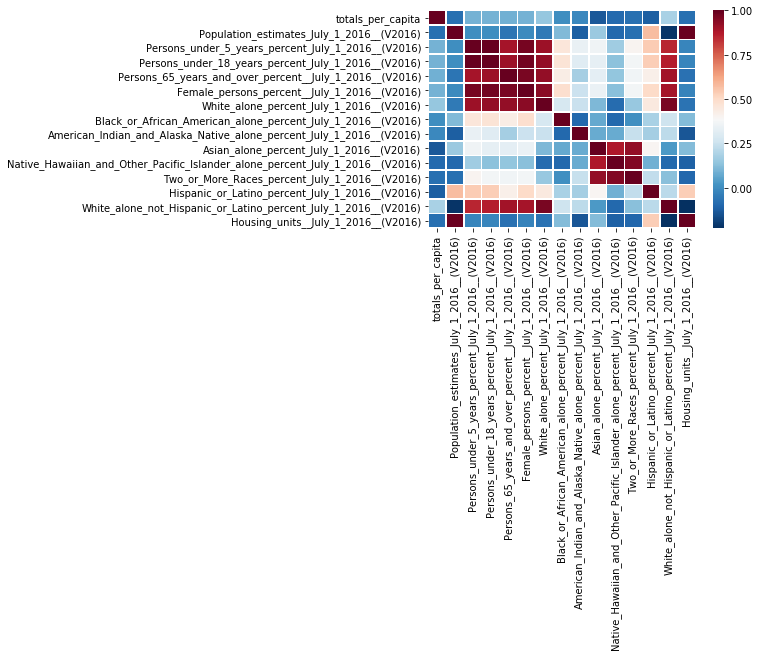

In [481]:
# Plot the correlation to have better visuals
sb.heatmap(pearsoncorr, 
            xticklabels=pearsoncorr.columns,
            yticklabels=pearsoncorr.columns,
            cmap='RdBu_r',
            annot=False,
            linewidth=0.5);

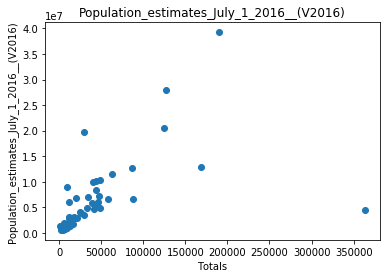

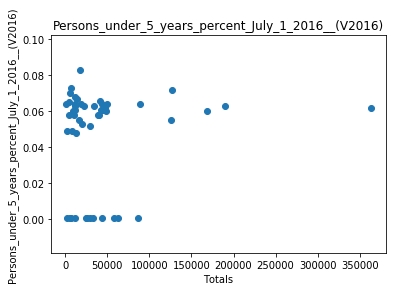

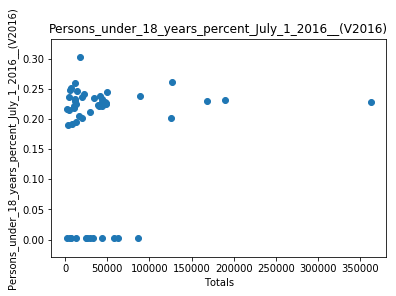

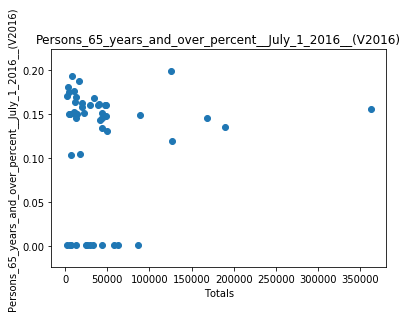

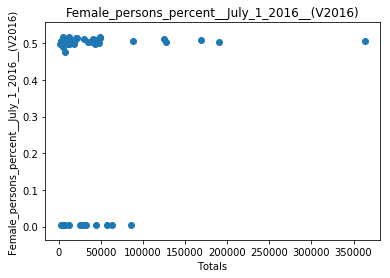

...

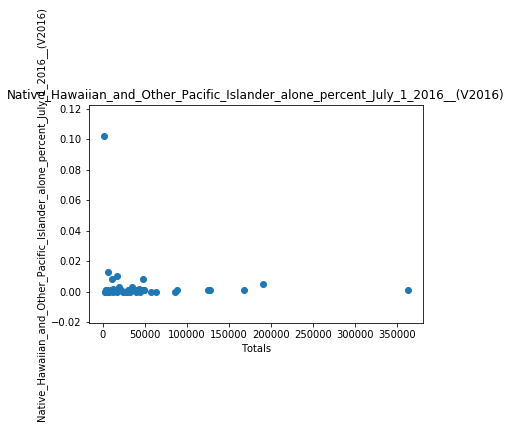

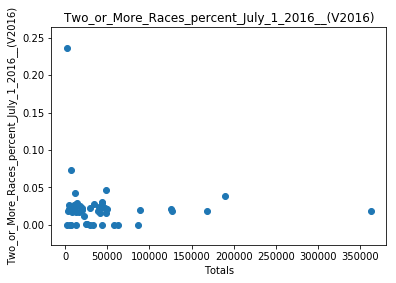

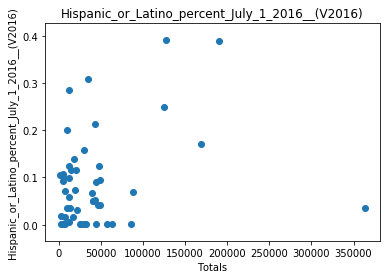

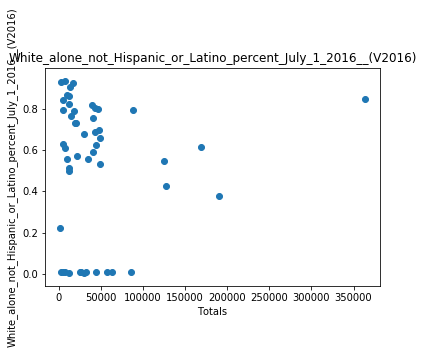

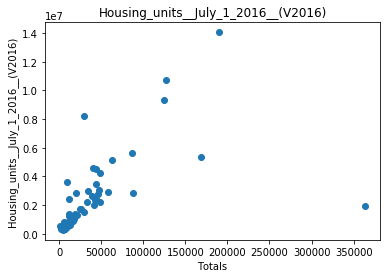

In [482]:
# Explore individual correlations
for i in list(census.columns):
    plt.scatter(df['totals'],df[i])
    plt.title(i)
    plt.xlabel('Totals')
    plt.ylabel(i)
    plt.show();

In [489]:
# Review Top 5 data
top5 = list(dfpc5.index)
for i in top5:
    dpl(census[(i):(i)].transpose().sort_values(i, ascending = False))

,Kentucky
Population_estimates_July_1_2016__(V2016),4436974.000000
Housing_units__July_1_2016__(V2016),1965556.000000
White_alone_percent_July_1_2016__(V2016),0.880000
White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),0.850000
Female_persons_percent__July_1_2016__(V2016),0.507000
Persons_under_18_years_percent_July_1_2016__(V2016),0.228000
Persons_65_years_and_over_percent__July_1_2016__(V2016),0.156000
Black_or_African_American_alone_percent_July_1_2016__(V2016),0.083000
Persons_under_5_years_percent_July_1_2016__(V2016),0.062000
Hispanic_or_Latino_percent_July_1_2016__(V2016),0.035000


,Indiana
Population_estimates_July_1_2016__(V2016),6633053.000000
Housing_units__July_1_2016__(V2016),2854546.000000
White_alone_percent_July_1_2016__(V2016),0.856000
White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),0.796000
Female_persons_percent__July_1_2016__(V2016),0.507000
Persons_under_18_years_percent_July_1_2016__(V2016),0.238000
Persons_65_years_and_over_percent__July_1_2016__(V2016),0.149000
Black_or_African_American_alone_percent_July_1_2016__(V2016),0.097000
Hispanic_or_Latino_percent_July_1_2016__(V2016),0.068000
Persons_under_5_years_percent_July_1_2016__(V2016),0.064000


,Illinois
Population_estimates_July_1_2016__(V2016),12801539.000000
Housing_units__July_1_2016__(V2016),5326970.000000
White_alone_percent_July_1_2016__(V2016),0.772000
White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),0.617000
Female_persons_percent__July_1_2016__(V2016),0.509000
Persons_under_18_years_percent_July_1_2016__(V2016),0.229000
Hispanic_or_Latino_percent_July_1_2016__(V2016),0.170000
Black_or_African_American_alone_percent_July_1_2016__(V2016),0.147000
Persons_65_years_and_over_percent__July_1_2016__(V2016),0.146000
Persons_under_5_years_percent_July_1_2016__(V2016),0.060000


,Alabama
Population_estimates_July_1_2016__(V2016),4863300.000000
Housing_units__July_1_2016__(V2016),2230185.000000
White_alone_percent_July_1_2016__(V2016),0.693000
White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),0.658000
Female_persons_percent__July_1_2016__(V2016),0.516000
Black_or_African_American_alone_percent_July_1_2016__(V2016),0.268000
Persons_under_18_years_percent_July_1_2016__(V2016),0.226000
Persons_65_years_and_over_percent__July_1_2016__(V2016),0.161000
Persons_under_5_years_percent_July_1_2016__(V2016),0.060000
Hispanic_or_Latino_percent_July_1_2016__(V2016),0.042000


,New Hampshire
Population_estimates_July_1_2016__(V2016),1334795.000000
Housing_units__July_1_2016__(V2016),625307.000000
White_alone_percent_July_1_2016__(V2016),0.938000
White_alone_not_Hispanic_or_Latino_percent_July_1_2016__(V2016),0.908000
Female_persons_percent__July_1_2016__(V2016),0.505000
Persons_under_18_years_percent_July_1_2016__(V2016),0.195000
Persons_65_years_and_over_percent__July_1_2016__(V2016),0.170000
Persons_under_5_years_percent_July_1_2016__(V2016),0.048000
Hispanic_or_Latino_percent_July_1_2016__(V2016),0.035000
Asian_alone_percent_July_1_2016__(V2016),0.027000


> For Kentucky, the highest percentage of people is White.

In [329]:
# Time to run the notebook
elapsed_time = time.time() - start_time
print('----- Completed in {} seconds -----'.format(elapsed_time))

----- Completed in 29.517624139785767 seconds -----


<a id='conclusions'></a>
## Conclusions

After get a couple of views of the data, being focused on gun per capita, I noted that the state with highest gun per capita in July 2016 is Kentucky, being followed by Indiana, Illinois, Alabama and New Hamphshire in the top 5. Also, I looked for correlations between high gun per capita and individual census and they are not strong, which makes me conclude that this indice is not directly related with the age, race, or gender. In fact, the highest percentage of people in the top 5 of gun per capita are white alone not hispanic or latino, which is most of the people in the U.S.

In [ ]:
from subprocess import call
call(['python', '-m', 'nbconvert', 'Investigate_a_Dataset.ipynb'])